### Weekly Exploration



Beginning the exploration of the target variable by checking the distribution of the weekly spread $y$ 

In [205]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns



df = pd.read_csv('C:/Users/wor_j/ML/School_projects/adv_ml_bond_project/price_impact/notebooks/data/weekly_spread.csv')

Clearly we have some outliers here. It would be proposterous to suggest that average bps for some of our spreads would be north of 300 bps. 


This would suggest that there are data logging errors, or perhaps we made a mistake in our computation. Given how thorough we were with data cleaning, I am inclined to believe that these errors must be some form of logging error, so I want to find out how often they occur in the data

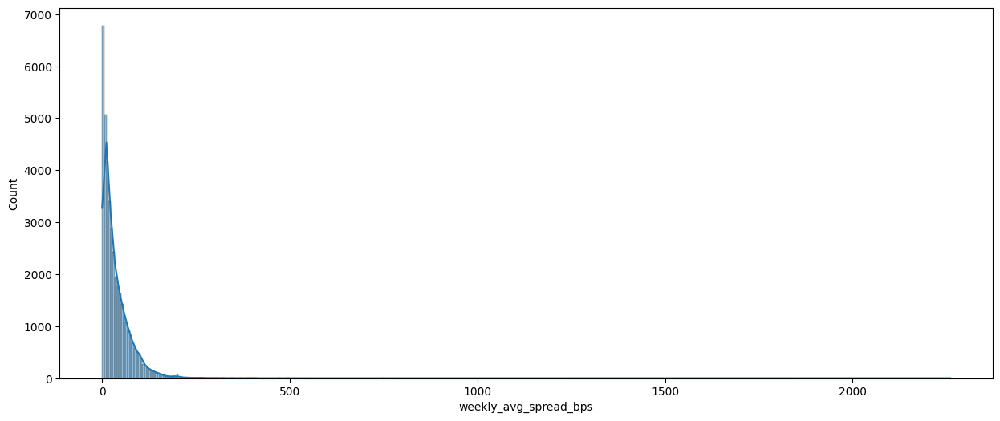

In [206]:
plt.figure(figsize=(15, 6))
sns.histplot(df['weekly_avg_spread_bps'], bins=400, kde=True)

plt.show()

So we can see that most of the distribution falls below 100 bps which is expected. To be safe perhaps we could set the threshold at around the 200 mark. 

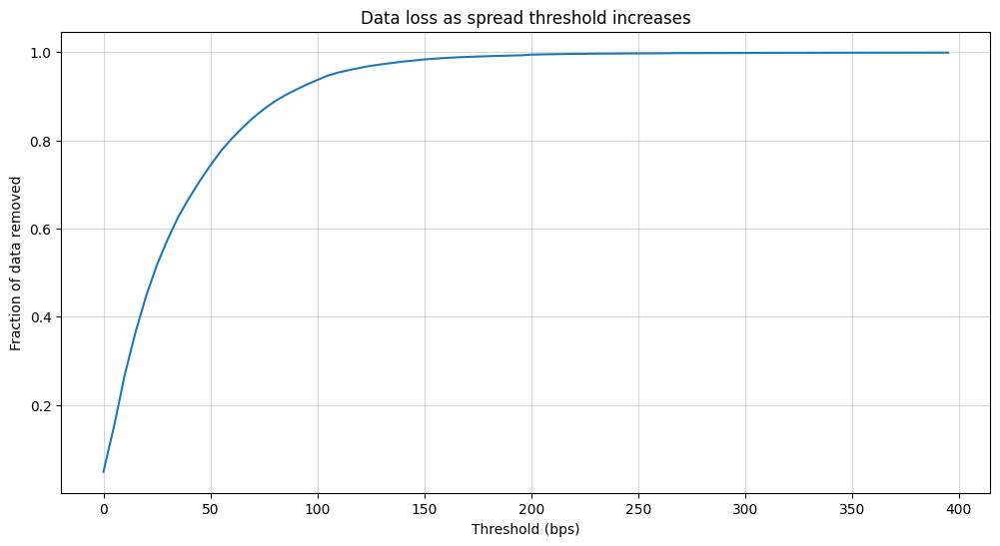

In [207]:
grid = np.arange(0, 400, 5)

loss = []
for t in grid:
    kept = (df['weekly_avg_spread_bps'] > t).sum()
    loss.append(1 - kept / len(df))  # fraction lost



plt.figure(figsize=(12,6))
plt.plot(grid, loss)
plt.xlabel("Threshold (bps)")
plt.ylabel("Fraction of data removed")
plt.title("Data loss as spread threshold increases")
plt.grid(True, alpha=0.5)
plt.show()



Alongside this, around 2.4% of the data is at zero, meaning we literally computed the spread as zero, or a trade did not happen during the week. 

These could be economically meaningful for the model, but they could be difficult to distinguish, perhaps we could include them later and test how performance differs, but for now I will treat these as noise so that we can capture the bulk of the distribution. 


The distribution appears to be inline with expectations (exponential distribution). 



The problem is, if we drop some of our values, not only will we have minor data loss, but also we might have temporal gaps. 

Percentage of zero spreads: 4.82%
If we remove the zero spreads and the spreads above 200bps and the zeros, we will get a distribution looking like this:


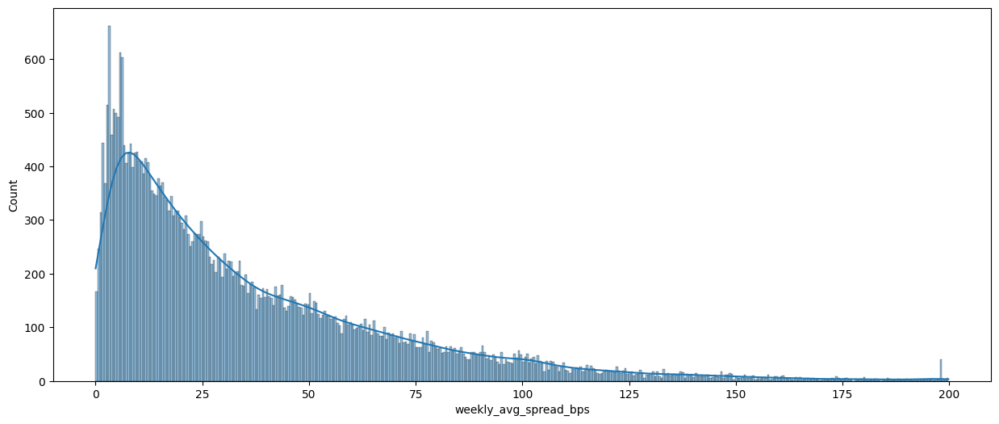

Percentage of for potential removal: 5.36%


In [208]:
zeros = df[df['weekly_avg_spread_bps'] == 0] 
print('Percentage of zero spreads:', f'{len(zeros) / len(df):.2%}')


new = df[(df['weekly_avg_spread_bps'] != 0) & (df['weekly_avg_spread_bps'] < 200)]

print('If we remove the zero spreads and the spreads above 200bps and the zeros, we will get a distribution looking like this:')

plt.figure(figsize=(15, 6))
sns.histplot(
    new['weekly_avg_spread_bps'],
    bins=400,
    kde=True
)

plt.show()


print('Percentage of for potential removal:', f'{1 - (len(new) / len(df)):.2%}')

Could explore the possibility of taking a log transform of the spread to make our distribution a bit safer for modeling, the likelihood is that we will do this as I am almost certain it will improve performance of our model. 

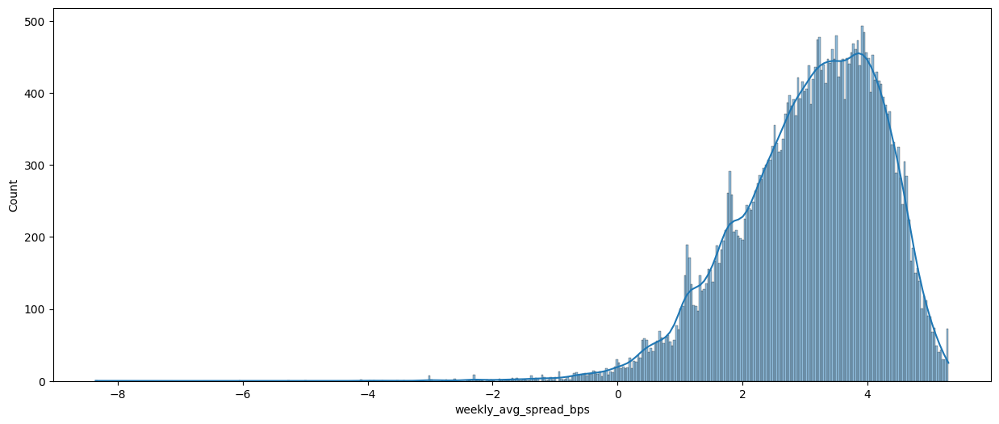

Number of positive infinity values: 0
Number of negative infinity values: 0


In [209]:
log_y = np.log(new['weekly_avg_spread_bps'])


plt.figure(figsize=(15, 6))
sns.histplot(log_y, bins=400, kde=True)

plt.show()



pos_inf = np.isinf(log_y).sum()
print('Number of positive infinity values:', pos_inf)
neg_inf = np.isinf(log_y).sum()
print('Number of negative infinity values:', neg_inf)





Looks like we have an anomaly in the amount of pairs we are handling, we will need to investigate this to see if this is another logging error. Given that there are no other local points surrounding this trading week, I am inclined to believe that this is probably an error. 




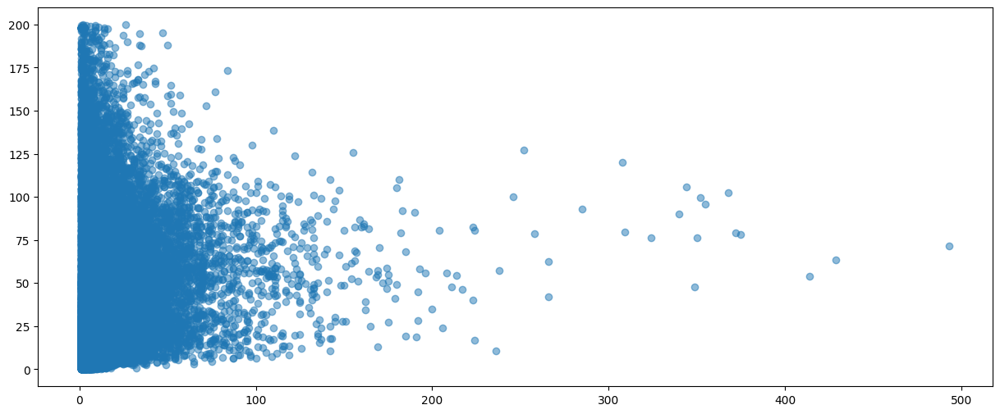

In [210]:
plt.figure(figsize=(15, 6))

plt.scatter(new['n_pairs'], new['weekly_avg_spread_bps'], alpha=0.5)


plt.show()

Looking at the series of the cusip, we can see that the other data points do not even come close to this, and also there was no sharp increase or decrease in spread following this shock event, which leads me to believe that this is yet another logging error.  

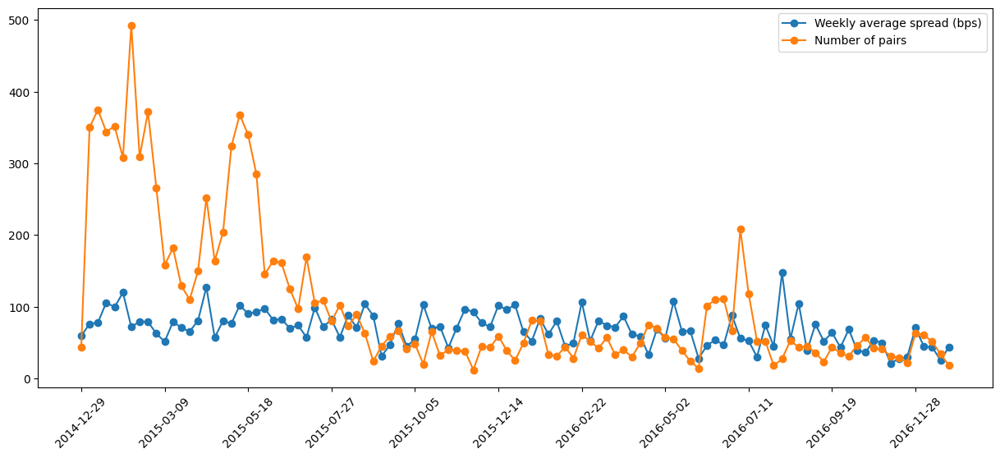

In [211]:


outlier = new['cusip_id'][new['n_pairs'] > 300].iloc[0]



series = new[new['cusip_id'] == outlier]


plt.figure(figsize=(15, 6))
plt.plot(series['week_start'], series['weekly_avg_spread_bps'], label='Weekly average spread (bps)',marker='o')
plt.plot(series['week_start'], series['n_pairs'], label='Number of pairs',marker='o')
plt.xticks(ticks=range(0, len(series), 10), rotation=45)
plt.legend()
plt.show()


Perhaps there are other cusips at this time which exhibit this behaviour, although I am doubtful. 

The visualization below is very insightful. 

Imagine the grid to depict the density of large trades occurring. We can see that the abnormally large trade does not occur when there is a large trade density, implying that this anomaly is likely an error of some kind. I would argue this depicts enough evidence to get rid of this observation. 

The graph below shows each cusip which has its own color, where the size is the spread, and we can see the number of pairs over time. But I only got the largest 500 trades in the dataset. So naturally we can see where the dense areas of large trades are. The colors also let us see if these volumes are specific to a bond or more a generic state of the market. 

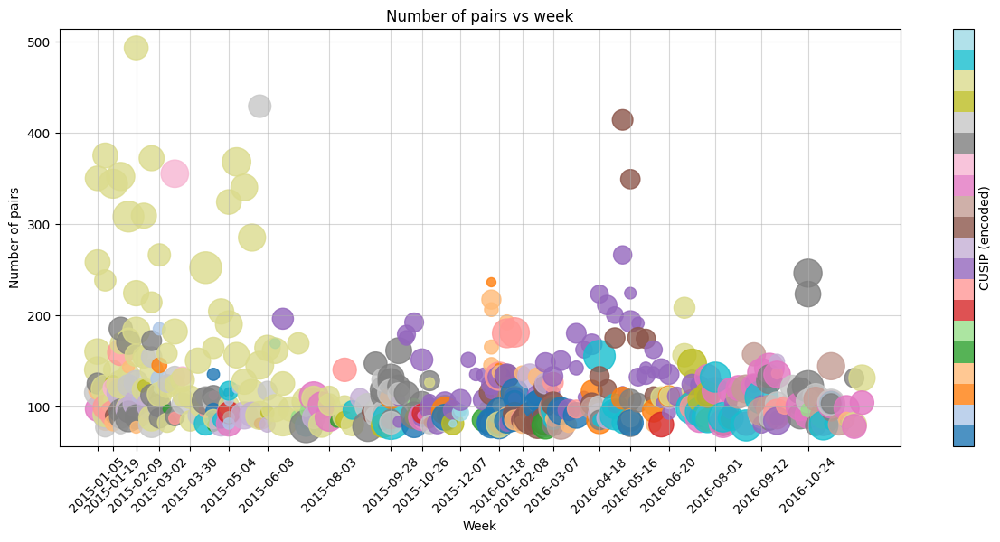

In [212]:
large = new.nlargest(500, 'n_pairs')[[
    'cusip_id','week_start','n_pairs','weekly_avg_spread_bps'
]]
large = large.sort_values('week_start')


# point size ∝ spread
size = large['weekly_avg_spread_bps'] * 5

# map CUSIPs → integer color codes
large['cusip_code'] = large['cusip_id'].astype('category').cat.codes

plt.figure(figsize=(15, 6))
plt.scatter(
    large['week_start'],
    large['n_pairs'],
    s=size,
    alpha=0.8,
    c=large['cusip_code'],   # color by CUSIP
    cmap='tab20'             # categorical-friendly palette
)

cbar = plt.colorbar(label='CUSIP (encoded)')
cbar.set_ticks([])  # optional: hide numeric ticks since codes aren't meaningful



plt.xticks(large['week_start'][::25], rotation=45)   # show 1 out of every 4
plt.grid(True, alpha=0.5)
plt.xlabel('Week')
plt.ylabel('Number of pairs')
plt.title('Number of pairs vs week')
plt.show()




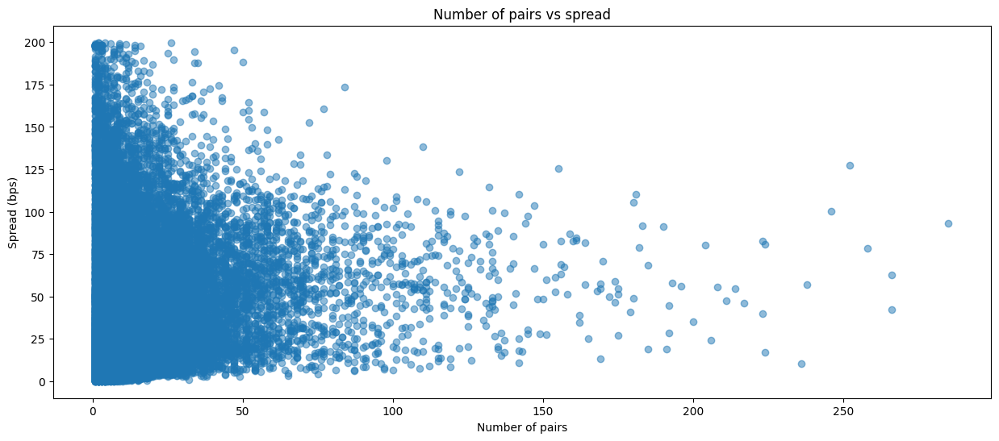

Correlation between spread and number of pairs: 0.18


In [213]:
new  = new[new['n_pairs'] <300]

plt.figure(figsize=(15, 6))

plt.scatter(new['n_pairs'], new['weekly_avg_spread_bps'], alpha=0.5)
plt.xlabel('Number of pairs')
plt.ylabel('Spread (bps)')
plt.title('Number of pairs vs spread')


plt.show()

print(f'Correlation between spread and number of pairs: {new["weekly_avg_spread_bps"].corr(new["n_pairs"]):.2f}')





After dropping some variables, we are going to have temporal gaps in the model. If we are forecasting liquidity, we need to ensure that the temporal structure remains. 

<Axes: xlabel='gap_weeks', ylabel='cusip_id'>

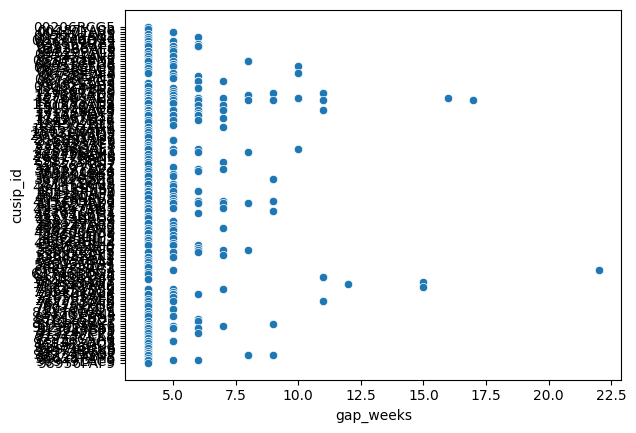

In [214]:
new['week_start'] = pd.to_datetime(new['week_start'])


new = new.sort_values(['cusip_id', 'week_start'])

new['gap_weeks'] = new.groupby('cusip_id')['week_start'].diff().dt.days // 7

gapped_data = new[new['gap_weeks'] > 3]

sns.scatterplot(x='gap_weeks', y='cusip_id', data=gapped_data)


In [221]:
new

,cusip_id,week_start,weekly_avg_spread_bps,n_pairs,gap_weeks
96,00206RAV4,2015-01-05,7.530180,8,NaN
386,00206RAV4,2015-01-12,4.958430,2,1.0
683,00206RAV4,2015-01-19,37.048656,4,1.0
980,00206RAV4,2015-01-26,18.396255,10,1.0
1277,00206RAV4,2015-02-02,7.979119,15,1.0
1577,00206RAV4,2015-02-09,15.525469,5,1.0
1888,00206RAV4,2015-02-16,10.290635,12,1.0
2189,00206RAV4,2015-02-23,8.180545,6,1.0
2490,00206RAV4,2015-03-02,13.933219,5,1.0
3119,00206RAV4,2015-03-16,12.043068,7,2.0


In [220]:
cusips = gapped_data['cusip_id'].unique().tolist()



gapped_data = new['gap_weeks']



test = new[~new['cusip_id'].isin(cusips)]











grid = np.arange(0, 25, 1)

loss = []
for t in grid:
    kept = (gapped_data['gap_weeks'] > t).sum()
    loss.append(1 - kept / len(df))  # fraction lost



plt.figure(figsize=(12,6))
plt.plot(grid, loss)
plt.xlabel("Threshold (weeks)")
plt.ylabel("Fraction of data removed")
plt.title("Data loss as gap threshold increases")
plt.xticks(grid, rotation=45)
plt.grid(True, alpha=0.5)
plt.show()







KeyError: 'gap_weeks'

In [216]:

test = new[~new['cusip_id'].isin(cusips)]
test

,cusip_id,week_start,weekly_avg_spread_bps,n_pairs,gap_weeks
96,00206RAV4,2015-01-05,7.530180,8,NaN
386,00206RAV4,2015-01-12,4.958430,2,1.0
683,00206RAV4,2015-01-19,37.048656,4,1.0
980,00206RAV4,2015-01-26,18.396255,10,1.0
1277,00206RAV4,2015-02-02,7.979119,15,1.0
1577,00206RAV4,2015-02-09,15.525469,5,1.0
1888,00206RAV4,2015-02-16,10.290635,12,1.0
2189,00206RAV4,2015-02-23,8.180545,6,1.0
2490,00206RAV4,2015-03-02,13.933219,5,1.0
3119,00206RAV4,2015-03-16,12.043068,7,2.0


In [217]:
test['gap_weeks'].value_counts()

gap_weeks
1.0    28106
2.0     1049
3.0      165
Name: count, dtype: int64

In [218]:
pd.set_option('display.max_rows', None)
test['cusip_id'].value_counts()

cusip_id
92343VBR4    105
92343VBQ6    105
852060AD4    105
06051GFD6    105
06051GEU9    105
037833AR1    105
037833AK6    105
037833AJ9    105
06051GFL8    105
36962G3P7    105
35671DBH7    105
38141GFM1    105
212015AH4    105
38141GRC0    105
38141GGQ1    105
71654QBG6    105
451102BF3    105
451102AX5    105
38148FAB5    105
46625HJJ0    105
92343VCQ5    105
92343VCN2    105
71647NAB5    105
35671DAU9    105
369604BC6    105
92857WBC3    105
94974BGA2    104
00206RCE0    104
71645WAN1    104
38141EC23    104
6174467X1    104
71645WAP6    104
03523TBP2    104
71647NAM1    104
06051GFH7    104
12543DAV2    104
037833AS9    104
852061AS9    104
85207UAF2    104
03524BAE6    104
156700AS5    104
931427AH1    104
92343VCR3    104
94974BFY1    104
38147MAA3    104
38145XAA1    104
38141GVM3    104
46625HJY7    104
71645WAR2    104
38141GGS7    104
38141GFD1    104
35671DAZ8    104
35671DBL8    104
35671DBC8    104
71647NAF6    104
46625HJZ4    104
49456BAE1    104
91911TAH6    104
00206

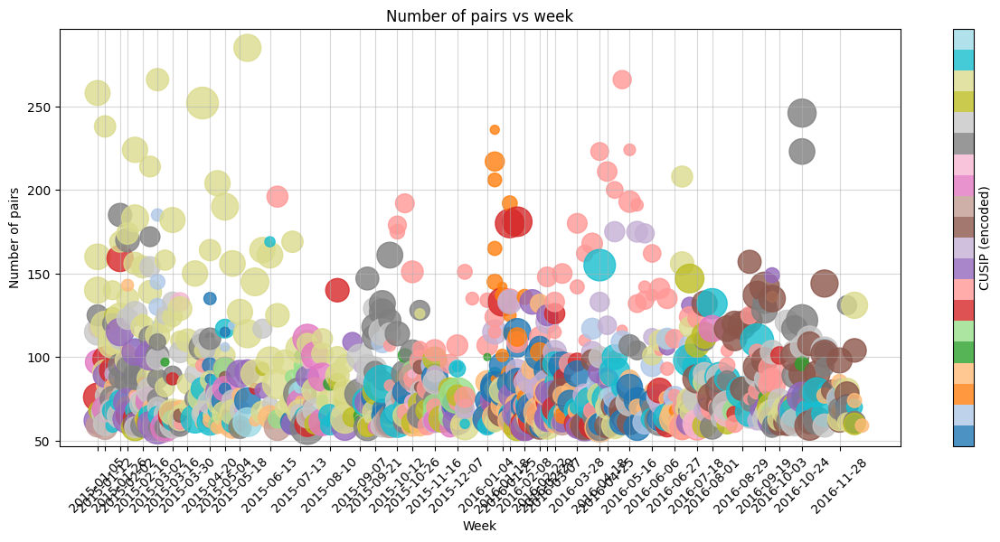

In [219]:


large = test


large = new.nlargest(1000, 'n_pairs')[[
    'cusip_id','week_start','n_pairs','weekly_avg_spread_bps'
]]
large = large.sort_values('week_start')

# point size ∝ spread
size = large['weekly_avg_spread_bps'] * 5

# map CUSIPs → integer color codes
large['cusip_code'] = large['cusip_id'].astype('category').cat.codes

plt.figure(figsize=(15, 6))
plt.scatter(
    large['week_start'],
    large['n_pairs'],
    s=size,
    alpha=0.8,
    c=large['cusip_code'],   # color by CUSIP
    cmap='tab20'             # categorical-friendly palette
)

cbar = plt.colorbar(label='CUSIP (encoded)')
cbar.set_ticks([])  # optional: hide numeric ticks since codes aren't meaningful



plt.xticks(large['week_start'][::25], rotation=45)   # show 1 out of every 4
plt.grid(True, alpha=0.5)
plt.xlabel('Week')
plt.ylabel('Number of pairs')
plt.title('Number of pairs vs week')
plt.show()


